In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
import statsmodels.api as sm
import sklearn.datasets
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.linear_model import LogisticRegression
import plotly.express as px
from plotly import graph_objects as go

In [ ]:
import nltk
from os import getcwd
import w1_unittest
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
import sklearn.datasets
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import LogisticRegression
from plotly import graph_objects as go

In [ ]:
import plotly.express as px

In [ ]:
!pip install plotly

In [ ]:
!pip install nltk

In [ ]:
df = pd.read_csv("merged-csv-files.csv")  # read from file
df.head() #show first 5 rows

,Unnamed: 0,title,score,id,subreddit,url,num_comments,body,created
0,0,Taliban to impose their interpretation of Shar...,48,yw8pn0,afghanistan,https://edition.cnn.com/2022/11/15/asia/taliba...,5,NaN,1668544393
1,1,The US has funneled more than $1 billion into ...,32,ylkkqy,afghanistan,https://taskandpurpose.com/news/us-military-fu...,5,NaN,1667523819
2,2,Afghans Increasingly Marrying Off Young Daught...,48,z9wkfe,afghanistan,https://gandhara.rferl.org/a/afghanistan-early...,1,NaN,1669921720
3,3,Afghans Show Mixed Feelings About US More Than...,10,z9wfxx,afghanistan,https://www.voanews.com/a/afghans-show-mixed-f...,2,NaN,1669921458
4,4,Afghanistan's Massoud urges elections to creat...,40,z96quq,afghanistan,https://www.reuters.com/world/asia-pacific/afg...,4,NaN,1669850117


In [ ]:
# check for missing values
df.isnull().sum()

Unnamed: 0         20
title               2
score               2
id                  2
subreddit           2
url                 2
num_comments        2
body            12093
created             2
dtype: int64

In [ ]:
# drop body column
df.drop(['body'], axis=1, inplace=True)

In [ ]:
# drop rows with missing values
df.dropna(inplace=True)

# drop Unnamed: 0 column
df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [ ]:
# check for missing values
df.isnull().sum()

title           0
score           0
id              0
subreddit       0
url             0
num_comments    0
created         0
dtype: int64

In [ ]:
# cleaning the data
df['title'] = df['title'].str.replace('[^\w\s]','')
df['title'] = df['title'].str.replace('\d+', '')
df['title'] = df['title'].str.lower()
df['title'] = df['title'].str.strip()

C:\Users\Laiba\AppData\Local\Temp/ipykernel_47748/312583950.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df['title'] = df['title'].str.replace('[^\w\s]','')
C:\Users\Laiba\AppData\Local\Temp/ipykernel_47748/312583950.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  df['title'] = df['title'].str.replace('\d+', '')


In [ ]:
# show title with the highest score region wise
# df.groupby(['subreddit'])['score'].max()

In [ ]:
# print title with the highest score and number of comments region wise
df.groupby(['subreddit'])['score', 'num_comments'].max()

C:\Users\Laiba\AppData\Local\Temp/ipykernel_47748/2874888706.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df.groupby(['subreddit'])['score', 'num_comments'].max()


,score,num_comments
subreddit,,
China,99,98
Colombia,99,94
Guyana,9,9
NorthKoreaNews,98,98
PanAmerica,98,9
Philippines,99,99
afghanistan,98,9
argentina,996,99
asia,9,9


In [ ]:
def topPosts(df, region):
    new_df = df[df['subreddit'] == region].sort_values(by=['score'], ascending=False)
    return new_df

In [ ]:
dfChina1 = topPosts(df,'China')
dfChina1.head(5)

,title,score,id,subreddit,url,num_comments,created
5540,guangzhou haizhu district has been rioting sin...,99,z83dku,China,https://v.redd.it/rcy4te75xx2a1,7,1669749887
5466,apple at its finest,99,z93cnd,China,https://i.redd.it/z58ongnul53a1.jpg,8,1669842640
6807,shoutout to the real mvps,99,z1vv1f,China,https://www.reddit.com/gallery/z1vv1f,14,1669129520
6695,fire in xinjiang,99,z46vet,China,https://v.redd.it/aua41891r12a1,20,1669360282
6327,hostile foreign forces have not given up their...,99,z95n7k,China,https://i.redd.it/hzqxag526w2a1.jpg,68,1669847616


In [ ]:
fig = px.treemap(dfChina1, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in colombia
dfColombia = topPosts(df,'Colombia')
dfColombia.head(5)

,title,score,id,subreddit,url,num_comments,created
7561,lo importante es apoyarnos entre latinos los l...,99,z4zilz,Colombia,https://i.redd.it/8nsf9a6xw82a1.jpg,0,1669441657
7449,me quieren extorsionar,97,z67qsd,Colombia,https://www.reddit.com/r/Colombia/comments/z67...,37,1669571758
7807,eso de tengo un pitbull y es un amor es una ma...,96,z2aubs,Colombia,https://www.reddit.com/r/Colombia/comments/z2a...,218,1669165119
7492,colombia tiene talento,95,z5qkia,Colombia,https://v.redd.it/lz0iptmkhc2a1,10,1669520421
7547,uno de los hombres más viejos de la historia e...,94,z597g5,Colombia,https://i.redd.it/loofzcfdnc2a1.jpg,12,1669474015


In [ ]:
fig = px.treemap(dfColombia, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in Guyana
dfGuyana = topPosts(df,'Guyana')
dfGuyana.head(5)

,title,score,id,subreddit,url,num_comments,created
10768,from here to the stars poetry by bethany sukhn...,9,t73blo,Guyana,https://www.amazon.ca/dp/B09Q2DQ29V/ref=cm_sw_...,1,1646461550
10642,headed back to the us after months in guyana,9,vzain4,Guyana,https://www.youtube.com/watch?v=xeHFeKYbya4,1,1657843850
10913,i did audio postproduction on eco travellers ...,9,qeytmg,Guyana,https://www.youtube.com/watch?v=L1wpJ1RSVuo,4,1635102516
10598,geography teacher here with questions from my ...,9,xm9pz2,Guyana,https://www.reddit.com/r/Guyana/comments/xm9pz...,4,1663968302
10946,google form latin americawould you defend your...,9,prhbhp,Guyana,https://www.reddit.com/r/Guyana/comments/prhbh...,0,1632088173


In [ ]:
fig = px.treemap(dfGuyana, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in NorthKoreaNews
#df[df['subreddit'] == 'NorthKoreaNews'].sort_values(by=['score'], ascending=False).head(5)
dfNorthkoreaNews = topPosts(df,'NorthKoreaNews')
dfNorthkoreaNews.head(5)

,title,score,id,subreddit,url,num_comments,created
13316,fbi releases wanted posters for two men accuse...,98,v1klzo,NorthKoreaNews,https://www.nknews.org/2022/05/fbi-releases-wa...,21,1653981418
13244,north korean soldiers wont fight in ukraine bu...,93,wmu7aw,NorthKoreaNews,https://www.nknews.org/2022/08/100000-north-ko...,11,1660333776
13235,rumors swirl that north korea preparing to all...,93,wxrk06,NorthKoreaNews,https://www.nknews.org/2022/08/rumors-swirl-th...,43,1661466537
13639,north korean fugitive recaptured in china afte...,92,r3z5dx,NorthKoreaNews,https://www.scmp.com/news/china/politics/artic...,15,1638086096
13179,an unvarnished look at the hidden backstreets ...,91,yevxn0,NorthKoreaNews,https://www.nknews.org/gallery/an-unvarnished-...,19,1666886949


In [ ]:
fig = px.treemap(dfNorthkoreaNews, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in PanAmerica
#df[df['subreddit'] == 'PanAmerica'].sort_values(by=['score'], ascending=False).head(5)
dfPanAmerica = topPosts(df,'PanAmerica')
dfPanAmerica.head(5)

,title,score,id,subreddit,url,num_comments,created
15183,latino civil rights organization drops latinx ...,98,rh0mwe,PanAmerica,https://www.nbcnews.com/news/latino/latino-civ...,15,1639579381
15005,you is not always tú in latín america,98,tggs2c,PanAmerica,https://i.redd.it/r9ihgyla8yn81.jpg,17,1647541687
15387,assuming an average speed of kmh a hyperloop t...,97,qrpb9j,PanAmerica,https://i.redd.it/ivfka5lpvzy71.png,16,1636649038
15187,a trinidadian soldier raising the us flag at t...,97,rggidi,PanAmerica,https://i.redd.it/0tvmuz5jik581.jpg,0,1639513763
15096,sports of the americas,96,s2bvf7,PanAmerica,https://i.redd.it/a9zd1frm3ha81.png,10,1642008744


In [ ]:
fig = px.treemap(dfPanAmerica, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in Philippines
#df[df['subreddit'] == 'Philippines'].sort_values(by=['score'], ascending=False).head(5)
dfPhilippines = topPosts(df,'Philippines')
dfPhilippines.head(5)

,title,score,id,subreddit,url,num_comments,created
15724,day of posting random animals that can be fou...,99,z8ommq,Philippines,https://www.reddit.com/gallery/z8ommq,10,1669806027
15764,percy lapids brother roy will continue his pol...,99,z8ixgr,Philippines,https://www.youtube.com/watch?v=VScIqQWbw-M,4,1669787376
15706,fried chicken sa kanto,978,z8btcg,Philippines,https://i.redd.it/y8uwutei013a1.jpg,208,1669769000
15715,nsfw should any lawmakers start any discussion...,95,z8qe6t,Philippines,https://www.reddit.com/r/Philippines/comments/...,64,1669811750
16148,baskin robbins ph,938,z54wz4,Philippines,https://i.redd.it/3nm01c79jb2a1.jpg,260,1669460522


In [ ]:
fig = px.treemap(dfPhilippines, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in afghanistan
#df[df['subreddit'] == 'afghanistan'].sort_values(by=['score'], ascending=False).head(5)
dfafghanistan = topPosts(df,'afghanistan')
dfafghanistan.head(5)

,title,score,id,subreddit,url,num_comments,created
185,female teacher sets up a makeshift school for ...,98,ybc472,afghanistan,https://i.redd.it/255hn42bmiv91.png,3,1666513401
552,heartbreaking video of andsf members crying as...,97,wo9qkx,afghanistan,https://v.redd.it/to7xsf4qbph91,5,1660492840
717,taliban threatened journalist lynne odonnell t...,97,w3ldxp,afghanistan,https://www.reddit.com/gallery/w3ldxp,4,1658320983
929,the uk uber experience as an afghan passenger,96,v9dhnq,afghanistan,https://i.redd.it/ahagibxt0u491.png,33,1654883647
975,who ever was involved in dadullah raid i woul...,95,v2bcsm,afghanistan,https://v.redd.it/c1yvcj5jiu291,1,1654068705


In [ ]:
fig = px.treemap(dfafghanistan, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in argentina
#df[df['subreddit'] == 'argentina'].sort_values(by=['score'], ascending=False).head(5)
dfargentina = topPosts(df,'argentina')
dfargentina.head(5)

,title,score,id,subreddit,url,num_comments,created
1371,pregunta de un estadounidense cómo pueden dorm...,996,z6biwx,argentina,https://i.redd.it/8hyiufpbgl2a1.png,326,1669580606
1742,mood,991,z380z8,argentina,https://i.redd.it/v8a0ab63ru1a1.jpg,83,1669257341
1413,argentina méxico el mejor momento para salir ...,99,z6f8ec,argentina,https://www.reddit.com/gallery/z6f8ec,56,1669589289
1819,,98,z33zv2,argentina,https://v.redd.it/ghmgext1cs1a1,22,1669246067
1443,hermosoooo,97,z64j8c,argentina,https://v.redd.it/9kpd9sw9mi2a1,7,1669564288


In [ ]:
fig = px.treemap(dfargentina, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in asia
#df[df['subreddit'] == 'asia'].sort_values(by=['score'], ascending=False).head(5)
dfasia = topPosts(df,'asia')
dfasia.head(5)

,title,score,id,subreddit,url,num_comments,created
2433,pictures from indonesia photos of people who ...,9,x36njd,asia,https://apnews.com/article/floods-indonesia-ja...,0,1662036041
2492,republic of korea navys slbmarmed submarines d...,9,wv0wi2,asia,https://www.navalnews.com/naval-news/2022/08/r...,3,1661192062
2649,kremlin strongly backs beijing as democratic u...,9,weaczt,asia,https://apnews.com/article/russia-ukraine-chin...,1,1659443217
2298,hurricanes powerful typhoon noru shifted abru...,9,xnhnwq,asia,https://apnews.com/article/storms-weather-phil...,1,1664094584
1905,china police beat staff protesting over workin...,9,z4fcce,asia,https://www.theguardian.com/world/video/2022/n...,1,1669388288


In [ ]:
fig = px.treemap(dfasia, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in bangladesh
#df[df['subreddit'] == 'bangladesh'].sort_values(by=['score'], ascending=False).head(5)
dfbangladesh= topPosts(df,'bangladesh')
dfbangladesh.head(5)

,title,score,id,subreddit,url,num_comments,created
3802,what is this ethereum like logo in tk note,97,xrf6nx,bangladesh,https://i.redd.it/wrudkqo4cuq91.jpg,24,1664475979
3638,projected imf real gdp growth rates in apac,92,y1t0h6,bangladesh,https://i.redd.it/nhzizp1roat91.jpg,35,1665545628
3220,a little bit change,91,yrhurb,bangladesh,https://i.redd.it/co7c4ubd35z91.png,17,1668093040
3594,মন সব কছতই,90,y5ay63,bangladesh,https://i.redd.it/telrtj4xi4u91.jpg,49,1665906874
3591,weekly thread on controversial topics read the...,9,y60ujd,bangladesh,https://www.reddit.com/r/bangladesh/comments/y...,5,1665979215


In [ ]:
fig = px.treemap(dfbangladesh, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in brasil
#df[df['subreddit'] == 'brasil'].sort_values(by=['score'], ascending=False).head(5)
dfbrasil= topPosts(df,'brasil')
dfbrasil.head(5)

,title,score,id,subreddit,url,num_comments,created
4552,alguém mais compartilha do meu desprezo pela s...,99,z644qr,brasil,https://www.reddit.com/r/brasil/comments/z644q...,66,1669563320
4112,a nova contratação da globo o repórter eli teral,989,z8az8o,brasil,https://v.redd.it/2m4lo3a1dz2a1,57,1669766993
4275,rapaz o facebook virou um manicômio,98,z7st92,brasil,https://www.reddit.com/r/brasil/comments/z7st9...,65,1669725164
4414,bumba meu boi painted by enrico bianco,97,z6ylr9,brasil,https://i.redd.it/ij40sxotgp2a1.jpg,1,1669647315
4375,kfc que tal um kgb,97,z76zvb,brasil,https://i.redd.it/x8rn80rpkq2a1.jpg,12,1669666273


In [ ]:
fig = px.treemap(dfbrasil, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in canada
#df[df['subreddit'] == 'canada'].sort_values(by=['score'], ascending=False).head(5)
dfcanada = topPosts(df,'canada')
dfcanada.head(5)

,title,score,id,subreddit,url,num_comments,created
4743,trudeau announces million in funding for sask...,976,z7a4b2,canada,https://www.cbc.ca/news/politics/trudeau-visit...,587,1669672988
5074,a quarter of canadians cant weather a recessio...,97,z1w11d,canada,https://ca.finance.yahoo.com/news/a-quarter-of...,132,1669129924
4981,tanzanians sue canadas barrick gold over alleg...,97,z36ku4,canada,https://www.aljazeera.com/news/2022/11/23/tanz...,16,1669253167
5328,quebec police arrest in alleged crossprovince...,97,yxq83t,canada,https://montreal.ctvnews.ca/quebec-police-arre...,50,1668691617
4832,ongoing work at the sitec hydroelectric projec...,967,z5f89z,canada,https://i.redd.it/hlccoer9gc2a1.jpg,290,1669489681


In [ ]:
fig = px.treemap(dfcanada, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in ecuador
#df[df['subreddit'] == 'ecuador'].sort_values(by=['score'], ascending=False).head(5)
dfecuador= topPosts(df,'ecuador')
dfecuador.head(5)

,title,score,id,subreddit,url,num_comments,created
9071,laguna amarilla los altares,96,yd5uvp,ecuador,https://i.redd.it/dgr1oi0nmyv91.jpg,4,1666707184
9605,si se pudo y si se puede,94,vi617l,ecuador,https://i.redd.it/ri1bn0p3j6791.jpg,7,1655906644
8880,gracias a ecuador todo el mundo quiere cerveza,92,z8hik7,ecuador,https://i.redd.it/wvguvob0p03a1.png,1,1669783287
9388,leprechaun restaurant in banos ecuador,91,whxh6u,ecuador,https://i.redd.it/3p6ts0jwk5g91.jpg,1,1659817776
9356,gay marriage in ecuador safe,9,wp428c,ecuador,https://www.reddit.com/r/ecuador/comments/wp42...,13,1660581101


In [ ]:
fig = px.treemap(dfecuador, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in europe
#df[df['subreddit'] == 'europe'].sort_values(by=['score'], ascending=False).head(5)
dfeurope = topPosts(df,'europe')
dfeurope.head(5)

,title,score,id,subreddit,url,num_comments,created
10122,the scanderbeg square in tirana build in desi...,99,z5zzcd,europe,https://i.redd.it/ikiv8e6y2j2a1.jpg,2,1669551892
10019,france ireland confirm celtic interconnector w...,98,z7b7k7,europe,https://www.euractiv.com/section/electricity/n...,4,1669675400
10369,buffeted by economic woes uk starts to look at...,96,z3h572,europe,https://www.nytimes.com/2022/11/22/world/europ...,80,1669287804
10469,china boosts efforts to control western infras...,96,z2lvm7,europe,https://www.reuters.com/world/china-boosts-eff...,4,1669200096
10408,gold coin proves fake roman emperor was real,94,z36vjg,europe,https://www.bbc.com/news/science-environment-6...,8,1669254010


In [ ]:
fig = px.treemap(dfeurope, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in india
#df[df['subreddit'] == 'india'].sort_values(by=['score'], ascending=False).head(5)
dfindia = topPosts(df,'india')
dfindia.head(5)

,title,score,id,subreddit,url,num_comments,created
11668,an elaborate bengali meal,964,z8sl7k,india,https://i.redd.it/zjcqirng153a1.jpg,74,1669817760
12010,ive become stuck and stagnant,91,z6vvm5,india,https://www.reddit.com/r/india/comments/z6vvm5...,61,1669640177
12198,need advice on employee bond,9,z61ll2,india,https://www.reddit.com/r/india/comments/z61ll2...,17,1669556726
11664,india will resume work in at least stalled pr...,9,z9uxtn,india,https://economictimes.indiatimes.com/news/indi...,11,1669918264
11830,job or farming,9,z8maf3,india,https://www.reddit.com/r/india/comments/z8maf3...,42,1669797689


In [ ]:
fig = px.treemap(dfindia, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in mexico
#df[df['subreddit'] == 'mexico'].sort_values(by=['score'], ascending=False).head(5)
dfmexico = topPosts(df,'mexico')
dfmexico.head(5)

,title,score,id,subreddit,url,num_comments,created
12808,yo digo que se arme,99,z5mhad,mexico,https://i.redd.it/dbgidwf9if2a1.png,20,1669508614
12315,pasandola bien mexico,98,z98toi,mexico,https://v.redd.it/1sb28xlhv73a1,4,1669855116
12620,malditos boomers que alcanzaron terrenos baratos,939,z6jprk,mexico,https://i.redd.it/d1kaw5jlll2a1.jpg,291,1669600910
12653,en la otra marcha no dejaron usar el zócalo y ...,937,z6aj6w,mexico,https://i.redd.it/89c9ejai9l2a1.jpg,616,1669578313
12504,venganza que piensan,936,z7egpp,mexico,https://i.redd.it/h1gsthyvwt2a1.jpg,146,1669683037


In [ ]:
fig = px.treemap(dfmexico, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in pakistan
#df[df['subreddit'] == 'pakistan'].sort_values(by=['score'], ascending=False).head(5)
dfpakistan= topPosts(df,'pakistan')
dfpakistan.head(5)

,title,score,id,subreddit,url,num_comments,created
14673,the army has no right to interfere in the gove...,99,yv9bsu,pakistan,https://i.redd.it/m4lmi88vtyz91.jpg,26,1668453003
14313,coas gen bajwa says failure in east pakistan i...,98,z2qgc4,pakistan,https://www.reddit.com/r/pakistan/comments/z2q...,91,1669213490
14171,rawalpindi jam packed,97,z571iz,pakistan,https://v.redd.it/eswxtx42na2a1,3,1669467696
14603,what was your favourite dictatorship,96,ywqxiw,pakistan,https://v.redd.it/b8tg9o83ta0a1,95,1668598076
14555,babaji not coming slow,95,yxrmea,pakistan,https://v.redd.it/ats92vaeti0a1,24,1668694986


In [ ]:
fig = px.treemap(dfpakistan, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
# print title with the highest score and number of comments in southafrica
#df[df['subreddit'] == 'southafrica'].sort_values(by=['score'], ascending=False).head(5)
dfsouthafrica= topPosts(df,'southafrica')
dfsouthafrica.head(5)

,title,score,id,subreddit,url,num_comments,created
16476,found in noordhoek,98,z3jmuy,southafrica,https://www.reddit.com/r/southafrica/comments/...,57,1669295612
16699,is it just me or did pannarotis really go down...,98,yw7jl9,southafrica,https://www.reddit.com/r/southafrica/comments/...,87,1668541638
16479,spotted at pnp inflation really got to this mayo,95,z3hczf,southafrica,https://i.redd.it/rbomtcyztv1a1.jpg,16,1669288567
16564,do you sit in the front or back of ubers,93,z0rtsb,southafrica,https://www.reddit.com/r/southafrica/comments/...,154,1669012730
16306,when the person you owe money to shows up to y...,92,z9hxyk,southafrica,https://v.redd.it/vnuzdctqe53a1,7,1669880791


In [ ]:
fig = px.treemap(dfsouthafrica, path=['subreddit', 'title'], values='score')
fig.show()

# plot trending topics in all locations

<AxesSubplot:>

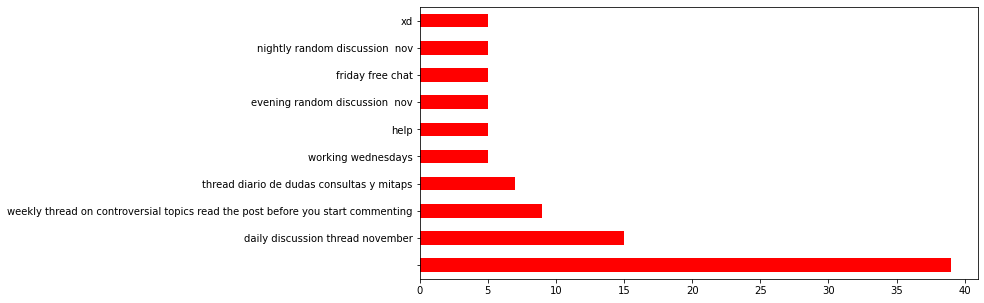

In [ ]:
df['title'].value_counts().head(10).plot(kind='barh', figsize=(10, 5), color='red')

In [ ]:
# plot trending topics region wise using treemap
fig = px.treemap(df, path=['subreddit', 'title'], values='score')
fig.show()

In [ ]:
fig = px.scatter(df, x="subreddit", y="score")
fig.show()

In [ ]:
#DOT PLOTS
fig = px.scatter(df, x="subreddit", y="score", color="num_comments", symbol="id")
fig.update_traces(marker_size=10)
fig.show()

In [ ]:
#Pie Charts
fig = px.pie(df,values="score", names="subreddit")
fig.show()

In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

In [ ]:


# frequency of Country
freq = df
freq = freq.subreddit.value_counts().reset_index().rename(columns={"index": "x"})
# Initialize figure with subplots
fig = make_subplots(
    rows=2, cols=2,
    column_widths=[0.6, 0.4],
    row_heights=[0.4, 0.6],
    specs=[[{"type": "scattergeo", "rowspan": 2}, {"type": "bar"}],
           [            None                    , {"type": "surface"}]])

# Add scattergeo globe map of news
fig.add_trace(
    go.Scattergeo(lat=df["num_comments"],
                  lon=df["score"],
                  mode="markers",
                  hoverinfo="text",
                  showlegend=False,
                  marker=dict(color="crimson", size=4, opacity=0.5)),
    row=1, col=1
)

# Add locations bar chart
fig.add_trace(
    go.Bar(x=freq["x"][0:10],y=freq["subreddit"][0:10], marker=dict(color="crimson"), showlegend=False),
    row=1, col=2
)

# Update geo subplot properties
fig.update_geos(
    projection_type="orthographic",
    landcolor="white",
    oceancolor="MidnightBlue",
    showocean=True,
    lakecolor="LightBlue"
)

# Set theme, margin, and annotation in layout
fig.update_layout(
    template="plotly_dark",
    margin=dict(r=10, t=25, b=100, l=60),
    annotations=[
        dict(
            text="World News",
            showarrow=False,
            xref="paper",
            yref="paper",
            x=0,
            y=0)
    ]
)

fig.show()

#

In [ ]:
df = pd.read_csv("merged-csv-files.csv")  # read from file
df.head() #show first 5 rows
df.drop(['body'], axis=1, inplace=True)
df.dropna(inplace=True)
df.drop(['Unnamed: 0'], axis=1, inplace=True)
df

,title,score,id,subreddit,url,num_comments,created
0,Taliban to impose their interpretation of Shar...,48,yw8pn0,afghanistan,https://edition.cnn.com/2022/11/15/asia/taliba...,5,1668544393
1,The US has funneled more than $1 billion into ...,32,ylkkqy,afghanistan,https://taskandpurpose.com/news/us-military-fu...,5,1667523819
2,Afghans Increasingly Marrying Off Young Daught...,48,z9wkfe,afghanistan,https://gandhara.rferl.org/a/afghanistan-early...,1,1669921720
3,Afghans Show Mixed Feelings About US More Than...,10,z9wfxx,afghanistan,https://www.voanews.com/a/afghans-show-mixed-f...,2,1669921458
4,Afghanistan's Massoud urges elections to creat...,40,z96quq,afghanistan,https://www.reuters.com/world/asia-pacific/afg...,4,1669850117
...,...,...,...,...,...,...,...
17909,Suspect in Memphis shooting rampage granted pu...,1,xa7t3w,usanews,https://www.pbs.org/newshour/nation/suspect-in...,0,1662760777
17910,Michigan Supreme Court ruling paves way for vo...,9,x9rymb,usanews,https://www.nbcnews.com/politics/2022-election...,1,1662719450
17911,North Korea declares itself a nuclear weapons ...,1,x9zk6s,usanews,https://www.bbc.com/news/world-asia-62845958,1,1662740013
17912,South Carolina Senate moves to further restric...,2,x9smxt,usanews,https://www.reuters.com/world/us/south-carolin...,0,1662721740


In [ ]:
df = pd.read_csv("merged-csv-files.csv")  # read from file
df.head() #show first 5 rows
df.drop(['body'], axis=1, inplace=True)
df.dropna(inplace=True)
df.drop(['Unnamed: 0'], axis=1, inplace=True)
df.drop(['url'], axis=1, inplace=True)
df

,title,score,id,subreddit,num_comments,created
0,Taliban to impose their interpretation of Shar...,48,yw8pn0,afghanistan,5,1668544393
1,The US has funneled more than $1 billion into ...,32,ylkkqy,afghanistan,5,1667523819
2,Afghans Increasingly Marrying Off Young Daught...,48,z9wkfe,afghanistan,1,1669921720
3,Afghans Show Mixed Feelings About US More Than...,10,z9wfxx,afghanistan,2,1669921458
4,Afghanistan's Massoud urges elections to creat...,40,z96quq,afghanistan,4,1669850117
...,...,...,...,...,...,...
17909,Suspect in Memphis shooting rampage granted pu...,1,xa7t3w,usanews,0,1662760777
17910,Michigan Supreme Court ruling paves way for vo...,9,x9rymb,usanews,1,1662719450
17911,North Korea declares itself a nuclear weapons ...,1,x9zk6s,usanews,1,1662740013
17912,South Carolina Senate moves to further restric...,2,x9smxt,usanews,0,1662721740


In [ ]:
df['title'] = df['title'].str.replace('[^\w\s]','')
df['title'] = df['title'].str.replace('\d+', '')
df['title'] = df['title'].str.lower()
df['title'] = df['title'].str.strip()

C:\Users\Laiba\AppData\Local\Temp/ipykernel_47748/3274105938.py:1: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Laiba\AppData\Local\Temp/ipykernel_47748/3274105938.py:2: FutureWarning:

The default value of regex will change from True to False in a future version.



#TOP NEWS THROUGHT gradientDescent

In [ ]:
def topPosts(df, region):
    new_df = df[df['subreddit'] == region].sort_values(by=['score'], ascending=False)
    return new_df

In [ ]:
dfChina1 = topPosts(df,'China')
dfChina1.head(5)

,title,score,id,subreddit,num_comments,created
5540,guangzhou haizhu district has been rioting sin...,99,z83dku,China,7,1669749887
5466,apple at its finest,99,z93cnd,China,8,1669842640
6807,shoutout to the real mvps,99,z1vv1f,China,14,1669129520
6695,fire in xinjiang,99,z46vet,China,20,1669360282
6327,hostile foreign forces have not given up their...,99,z95n7k,China,68,1669847616


In [ ]:
 nltk.download('twitter_samples')

[nltk_data] Downloading package twitter_samples to
[nltk_data]     C:\Users\Laiba\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\twitter_samples.zip.


True

In [ ]:
import nltk

In [ ]:
import numpy as np
import pandas as pd
from nltk.corpus import twitter_samples
from utils import process_tweet, build_freqs

In [ ]:
# select the set of positive and negative tweets
all_positive_tweets = twitter_samples.strings('positive_tweets.json')
all_negative_tweets = twitter_samples.strings('negative_tweets.json')

# split the data into two pieces, one for training and one for testing (validation set)
test_pos = all_positive_tweets[4000:]
train_pos = all_positive_tweets[:4000]
test_neg = all_negative_tweets[4000:]
train_neg = all_negative_tweets[:4000]

train_x = train_pos + train_neg
test_x = test_pos + test_neg

In [ ]:
# combine positive and negative labels
train_y = np.append(np.ones((len(train_pos), 1)), np.zeros((len(train_neg), 1)), axis=0)
test_y = np.append(np.ones((len(test_pos), 1)), np.zeros((len(test_neg), 1)), axis=0)

In [ ]:
# create frequency dictionary
freqs = build_freqs(train_x, train_y)

# check the output
print("type(freqs) = " + str(type(freqs)))
print("len(freqs) = " + str(len(freqs.keys())))

type(freqs) = <class 'dict'>
len(freqs) = 11428


In [ ]:
def sigmoid(z):
    h=1/(1+np.exp(-z))

    return h

# Testing your function
if (sigmoid(0) == 0.5):
    print('SUCCESS!')
else:
    print('Oops!')

if (sigmoid(4.92) == 0.9927537604041685):
    print('CORRECT!')
else:
    print('Oops again!')

SUCCESS!
CORRECT!


In [ ]:
def gradientDescent(x, y, theta, alpha, num_iters):

    m = None
    m = x.shape[0]
    for i in range(0, num_iters):
        z = x.dot(theta) ##as it is given us the varvalie
        #getting the sigmoid function
        h = sigmoid(z)
        J = -1/m*((np.transpose(y).dot(np.log(h))) + (np.transpose(1-y).dot(np.log(1-h))))
        # update the weights theta
        theta = theta - (alpha/m) *(np.transpose(x).dot(h-y))
    J = float(J)
    return J, theta

In [ ]:
def extract_features(tweet, freqs, process_tweet=process_tweet):

    word_l = process_tweet(tweet)
    x = np.zeros((1, 3))
    x[0,0] = 1

    for word in word_l:

        temp=(word,0)
        temp1=(word,1)

        if ((word,0) in freqs):
            temp3=freqs[temp]
            x[0,2]=x[0,2]+temp3

        if ((word,1) in freqs):
                temp4=freqs[temp1]
                x[0,1]=x[0,1]+temp4

    assert(x.shape == (1, 3))
    return x

In [ ]:
# collect the features 'x' and stack them into a matrix 'X'
X = np.zeros((len(train_x), 3))
for i in range(len(train_x)):
    X[i, :]= extract_features(train_x[i], freqs)
Y = train_y

# Apply gradient descent
J, theta = gradientDescent(X, Y, np.zeros((3, 1)), 1e-9, 1500)

In [ ]:
def predict_tweet(tweet, freqs, theta):

    x = extract_features(tweet,freqs)
    y_pred = sigmoid(np.dot(x,theta))

    return y_pred

#test_logistic_regression

In [ ]:
def test_logistic_regression(test_x, test_y, freqs, theta, predict_tweet=predict_tweet):

    y_hat = []

    for tweet in test_x:
        y_pred = predict_tweet(tweet, freqs, theta)

        if y_pred > 0.5:
            y_hat.append(1.0)
        else:
            y_hat.append(0.0)

    y_hat=np.array(y_hat)
    test_y=test_y.flatten()
    a=0
    for i in range(0,len(y_hat)):
        if y_hat[i]==test_y[i]:
            a+=1

    accuracy = a/len(test_y)
    accuracy=np.float64(accuracy)

    return accuracy


# function to find sentiment of top 5 posts of each region

In [ ]:
def check_sentiment(df,list1):
    col_list = df.title.values.tolist()

    for i in range(len(col_list)):
        my_tweet = col_list[i]
        y_hat = predict_tweet(my_tweet, freqs, theta)
        print(y_hat)
        if y_hat > 0.5:
            list1.append("Positive")
            #print('Positive sentiment')
        else:
            list1.append("Negative")
            #print('Negative sentiment')

In [ ]:
df1 = dfChina1.head(20)
china_sentiment = []
check_sentiment(df1,china_sentiment)
china_sentiment

[[0.49320562]]
[[0.49998493]]
[[0.50004408]]
[[0.49999499]]
[[0.50251118]]
[[0.49998493]]
[[0.50004408]]
[[0.49999499]]
[[0.49320562]]
[[0.50251118]]
[[0.49881571]]
[[0.49881571]]
[[0.49409052]]
[[0.49409052]]
[[0.49993951]]
[[0.50068347]]
[[0.50068347]]
[[0.49993951]]
[[0.50000002]]
[[0.49833916]]


['Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative']

In [ ]:
list1 = [china_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T

# add columns
data.columns = ['sentiment']

# display
data

,sentiment
0,Negative
1,Negative
2,Positive
3,Negative
4,Positive
5,Negative
6,Positive
7,Negative
8,Negative
9,Positive


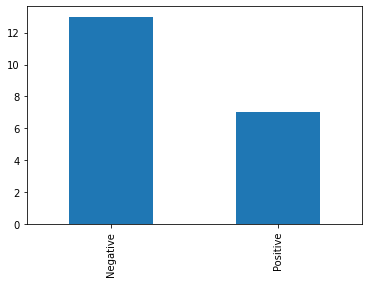

In [ ]:
ax = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# ecuador

In [ ]:
df1 = dfecuador.head(20)
ecuador_sentiment = []
check_sentiment(df1,ecuador_sentiment)
ecuador_sentiment


[[0.49986044]]
[[0.500498]]
[[0.49999499]]
[[0.50000002]]
[[0.49940652]]
[[0.52006551]]
[[0.50026911]]
[[0.50296894]]
[[0.49773816]]
[[0.5002981]]
[[0.50038355]]
[[0.4998152]]
[[0.5074263]]
[[0.49968065]]
[[0.50037853]]
[[0.50109534]]
[[0.49982022]]
[[0.50000002]]
[[0.49950086]]
[[0.50000002]]


['Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive']

In [ ]:

list1 = [ecuador_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############







,sentiment
0,Negative
1,Positive
2,Negative
3,Positive
4,Negative
5,Positive
6,Positive
7,Positive
8,Negative
9,Positive


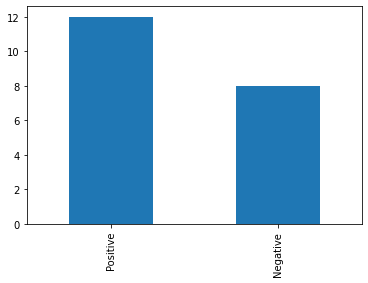

In [ ]:
ax = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# GUYANA

In [ ]:
df1 = dfGuyana.head(20)
Guyana_sentiment = []
check_sentiment(df1,Guyana_sentiment)
Guyana_sentiment


[[0.50079223]]
[[0.51112351]]
[[0.50551696]]
[[0.50506662]]
[[0.50531023]]
[[0.50104624]]
[[0.51047503]]
[[0.50498653]]
[[0.50691551]]
[[0.50032826]]
[[0.50013456]]
[[0.5036192]]
[[0.49833399]]
[[0.50229504]]
[[0.50000002]]
[[0.49903187]]
[[0.50799218]]
[[0.49656865]]
[[0.49957123]]
[[0.47043709]]


['Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative']

In [ ]:
list1 = [Guyana_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############


,sentiment
0,Positive
1,Positive
2,Positive
3,Positive
4,Positive
5,Positive
6,Positive
7,Positive
8,Positive
9,Positive


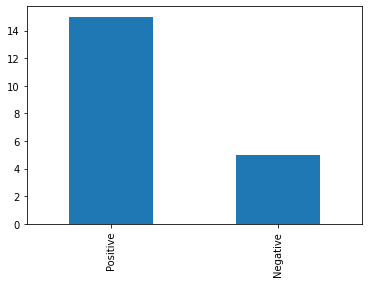

In [ ]:
ax = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#  COLOMBIA

In [ ]:
df1 = dfColombia.head(20)
Colombia_sentiment = []

check_sentiment(df1,Colombia_sentiment)
Colombia_sentiment


[[0.50026911]]
[[0.50000002]]
[[0.50192776]]
[[0.49986044]]
[[0.5000843]]
[[0.49998493]]
[[0.50026911]]
[[0.49997991]]
[[0.49975873]]
[[0.49999499]]
[[0.49969573]]
[[0.49986044]]
[[0.49939647]]
[[0.49971081]]
[[0.49953605]]
[[0.50026911]]
[[0.49928706]]
[[0.50000002]]
[[0.49983028]]
[[0.50041757]]


['Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive']

In [ ]:
list1 = [Colombia_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############


,sentiment
0,Positive
1,Positive
2,Positive
3,Negative
4,Positive
5,Negative
6,Positive
7,Negative
8,Negative
9,Negative


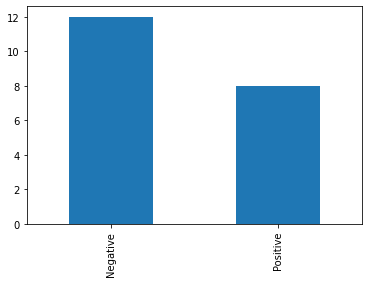

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#  NORTHKOREANEWS

In [ ]:
df1 = dfNorthkoreaNews.head(20)
NorthkoreaNews_sentiment = []
check_sentiment(df1,NorthkoreaNews_sentiment)
NorthkoreaNews_sentiment


[[0.48605644]]
[[0.50033211]]
[[0.49965199]]
[[0.50945166]]
[[0.50417747]]
[[0.50083009]]
[[0.5020437]]
[[0.49625432]]
[[0.50944011]]
[[0.49556772]]
[[0.49984536]]
[[0.50725275]]
[[0.49541575]]
[[0.49948578]]
[[0.50026911]]
[[0.49997488]]
[[0.5010501]]
[[0.50005916]]
[[0.5023391]]
[[0.50187129]]


['Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive']

In [ ]:
list1 = [NorthkoreaNews_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Negative
1,Positive
2,Negative
3,Positive
4,Positive
5,Positive
6,Positive
7,Negative
8,Positive
9,Negative


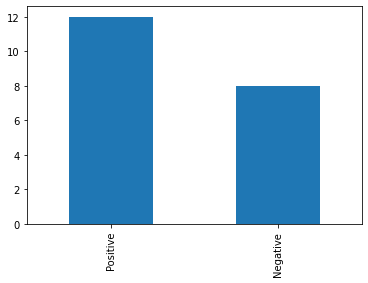

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#   dfPanAmerica

In [ ]:
df1 = dfPanAmerica.head(20)
PanAmerica_sentiment = []
check_sentiment(df1,PanAmerica_sentiment)
PanAmerica_sentiment


[[0.50390453]]
[[0.4997537]]
[[0.49695988]]
[[0.50815534]]
[[0.50053318]]
[[0.50037853]]
[[0.49942161]]
[[0.61685242]]
[[0.58703042]]
[[0.49896032]]
[[0.50040366]]
[[0.50028302]]
[[0.49971081]]
[[0.49835678]]
[[0.4999598]]
[[0.4997537]]
[[0.50077715]]
[[0.50198305]]
[[0.49132238]]
[[0.50327204]]


['Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive']

In [ ]:
list1 = [PanAmerica_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Negative
3,Positive
4,Positive
5,Positive
6,Negative
7,Positive
8,Positive
9,Negative


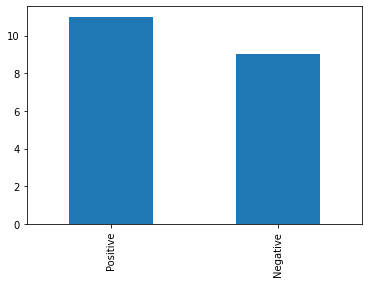

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

 #  Philippines

In [ ]:
df1 = dfPhilippines.head(20)
Philippines_sentiment = []
check_sentiment(df1,Philippines_sentiment)
Philippines_sentiment


[[0.51052143]]
[[0.49970461]]
[[0.49868854]]
[[0.50262948]]
[[0.49972086]]
[[0.50783986]]
[[0.49968065]]
[[0.50655383]]
[[0.4999598]]
[[0.49897305]]
[[0.49983531]]
[[0.49834907]]
[[0.49968065]]
[[0.49801078]]
[[0.49727655]]
[[0.49574397]]
[[0.49993852]]
[[0.49989093]]
[[0.4954749]]
[[0.4957475]]


['Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative']

In [ ]:
list1 = [Philippines_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Negative
3,Positive
4,Negative
5,Positive
6,Negative
7,Positive
8,Negative
9,Negative


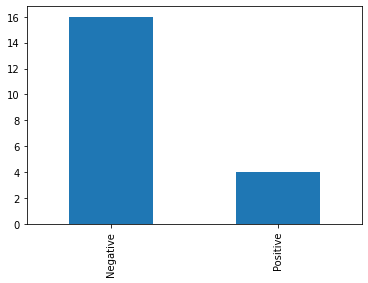

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#  afghanistan

In [ ]:
df1 = dfafghanistan.head(20)
afghanistan_sentiment = []
check_sentiment(df1,afghanistan_sentiment)
afghanistan_sentiment


[[0.50014227]]
[[0.45296537]]
[[0.49900673]]
[[0.50021885]]
[[0.57194915]]
[[0.49805282]]
[[0.50670461]]
[[0.4953226]]
[[0.49622567]]
[[0.50077212]]
[[0.50190765]]
[[0.50800608]]
[[0.49330764]]
[[0.50223204]]
[[0.49999381]]
[[0.5054853]]
[[0.4982849]]
[[0.50149781]]
[[0.49727153]]
[[0.49633977]]


['Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative']

In [ ]:
list1 = [afghanistan_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Negative
3,Positive
4,Positive
5,Negative
6,Positive
7,Negative
8,Negative
9,Positive


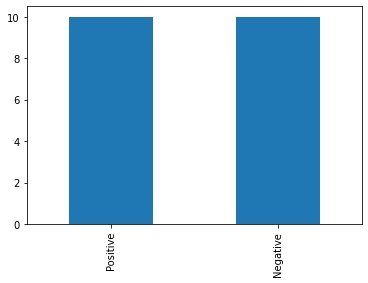

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#  argentina

In [ ]:
df1 = dfargentina.head(20)
argentina_sentiment = []
check_sentiment(df1,argentina_sentiment)
argentina_sentiment


[[0.49984536]]
[[0.50052816]]
[[0.49985039]]
[[0.50000002]]
[[0.50000002]]
[[0.49968065]]
[[0.50016355]]
[[0.50020376]]
[[0.4997398]]
[[0.49915753]]
[[0.49982022]]
[[0.49984033]]
[[0.49937134]]
[[0.49986044]]
[[0.49997991]]
[[0.50088154]]
[[0.49941658]]
[[0.49941658]]
[[0.49998996]]
[[0.49837923]]


['Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative']

In [ ]:
list1 = [argentina_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Negative
1,Positive
2,Negative
3,Positive
4,Positive
5,Negative
6,Positive
7,Positive
8,Negative
9,Negative


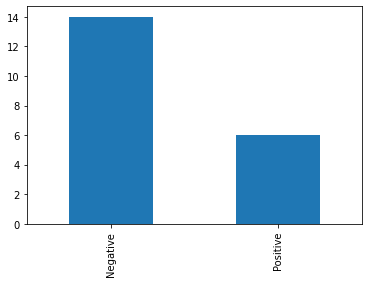

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# asia

In [ ]:
df1 = dfasia.head(20)
asia_sentiment = []
check_sentiment(df1,asia_sentiment)
asia_sentiment


[[0.49342558]]
[[0.49849283]]
[[0.51251849]]
[[0.49238074]]
[[0.50014377]]
[[0.49978269]]
[[0.49791024]]
[[0.50122871]]
[[0.49966557]]
[[0.49984033]]
[[0.4960923]]
[[0.49980514]]
[[0.49968065]]
[[0.50560978]]
[[0.50184498]]
[[0.49962921]]
[[0.49698149]]
[[0.50093951]]
[[0.50231129]]
[[0.50025403]]


['Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive']

In [ ]:
list1 = [asia_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Negative
1,Negative
2,Positive
3,Negative
4,Positive
5,Negative
6,Negative
7,Positive
8,Negative
9,Negative


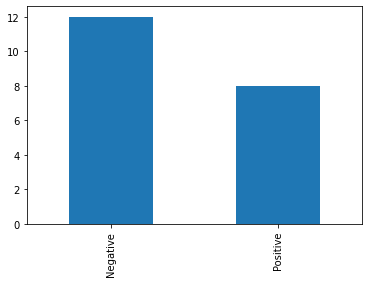

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# bangladesh

In [ ]:
df1 = dfbangladesh.head(20)
bangladesh_sentiment = []
check_sentiment(df1,bangladesh_sentiment)
bangladesh_sentiment


[[0.50056015]]
[[0.5001535]]
[[0.50148775]]
[[0.50000002]]
[[0.50544861]]
[[0.49883079]]
[[0.50107641]]
[[0.50186241]]
[[0.49938642]]
[[0.49986044]]
[[0.50528124]]
[[0.49854897]]
[[0.50000002]]
[[0.50104122]]
[[0.49543468]]
[[0.50016355]]
[[0.50119587]]
[[0.49999499]]
[[0.49942161]]
[[0.50053318]]


['Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Positive']

In [ ]:
list1 = [bangladesh_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Positive
2,Positive
3,Positive
4,Positive
5,Negative
6,Positive
7,Positive
8,Negative
9,Negative


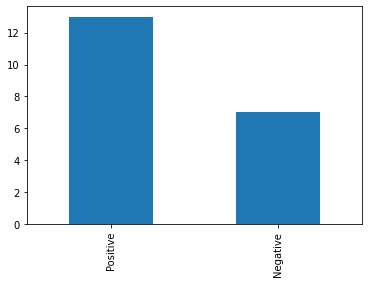

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#  brasil

In [ ]:
df1 = dfbrasil.head(20)
brasil_sentiment = []
check_sentiment(df1,brasil_sentiment)
brasil_sentiment


[[0.50000002]]
[[0.49984033]]
[[0.50011446]]
[[0.50025403]]
[[0.50012451]]
[[0.4992569]]
[[0.49890737]]
[[0.50026409]]
[[0.50012954]]
[[0.50009938]]
[[0.49999499]]
[[0.49999499]]
[[0.49983028]]
[[0.49996985]]
[[0.49999499]]
[[0.50008932]]
[[0.49986044]]
[[0.50000002]]
[[0.49980012]]
[[0.49971584]]


['Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative']

In [ ]:
list1 = [brasil_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Positive
3,Positive
4,Positive
5,Negative
6,Negative
7,Positive
8,Positive
9,Positive


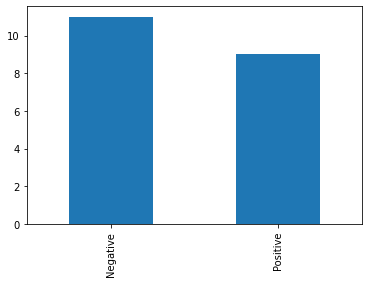

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# canada

In [ ]:
df1 = dfcanada.head(20)
canada_sentiment = []
check_sentiment(df1,canada_sentiment)
canada_sentiment


[[0.50216552]]
[[0.49333981]]
[[0.50060741]]
[[0.49983531]]
[[0.49454705]]
[[0.50299792]]
[[0.50184348]]
[[0.50833541]]
[[0.49711335]]
[[0.49251911]]
[[0.49924684]]
[[0.50703279]]
[[0.50369192]]
[[0.52252665]]
[[0.49752051]]
[[0.49713816]]
[[0.49592492]]
[[0.50182337]]
[[0.49983531]]
[[0.50026409]]


['Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive']

In [ ]:
list1 = [canada_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Positive
3,Negative
4,Negative
5,Positive
6,Positive
7,Positive
8,Negative
9,Negative


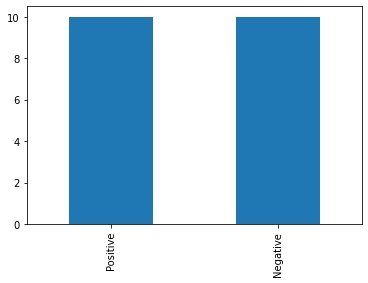

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# europe

In [ ]:
df1 = dfeurope.head(20)
europe_sentiment = []
check_sentiment(df1,europe_sentiment)
europe_sentiment

[[0.50237161]]
[[0.50106635]]
[[0.50556069]]
[[0.4995461]]
[[0.50178316]]
[[0.49986932]]
[[0.4989816]]
[[0.50052816]]
[[0.50046784]]
[[0.50469199]]
[[0.50051308]]
[[0.49863893]]
[[0.49880298]]
[[0.49806255]]
[[0.49925187]]
[[0.50043768]]
[[0.49781976]]
[[0.50756702]]
[[0.50209749]]
[[0.50448056]]


['Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive']

In [ ]:
list1 = [europe_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Positive
2,Positive
3,Negative
4,Positive
5,Negative
6,Negative
7,Positive
8,Positive
9,Positive


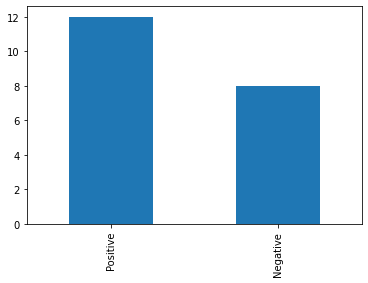

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# india

In [ ]:
df1 = dfindia.head(20)
india_sentiment = []
check_sentiment(df1,india_sentiment)
india_sentiment

[[0.49971584]]
[[0.49867849]]
[[0.49768404]]
[[0.49845999]]
[[0.50358754]]
[[0.49660383]]
[[0.50114561]]
[[0.492695]]
[[0.49966087]]
[[0.49817229]]
[[0.49696105]]
[[0.49980514]]
[[0.50007692]]
[[0.49381375]]
[[0.49971081]]
[[0.50046163]]
[[0.50505036]]
[[0.49028135]]
[[0.49997488]]
[[0.50542348]]


['Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Negative',
 'Positive']

In [ ]:
list1 = [india_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Negative
1,Negative
2,Negative
3,Negative
4,Positive
5,Negative
6,Positive
7,Negative
8,Negative
9,Negative


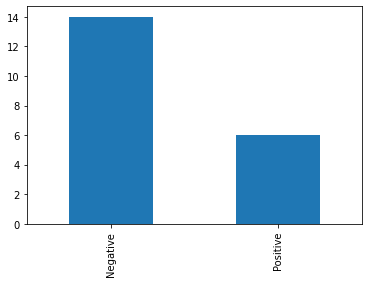

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# mexico

In [ ]:
df1 = dfmexico.head(20)
mexico_sentiment = []
check_sentiment(df1,mexico_sentiment)
mexico_sentiment

[[0.5002289]]
[[0.50026409]]
[[0.49986044]]
[[0.49968065]]
[[0.49986044]]
[[0.50000002]]
[[0.49350966]]
[[0.49982022]]
[[0.50012954]]
[[0.50023895]]
[[0.49958129]]
[[0.50237664]]
[[0.50061512]]
[[0.50108026]]
[[0.49956621]]
[[0.50092678]]
[[0.50012451]]
[[0.50013456]]
[[0.49985039]]
[[0.49967562]]


['Positive',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Negative']

In [ ]:
list1 = [mexico_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Positive
2,Negative
3,Negative
4,Negative
5,Positive
6,Negative
7,Negative
8,Positive
9,Positive


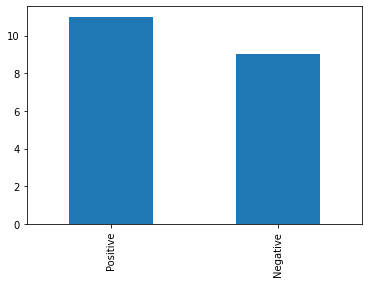

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# pakistan

In [ ]:
df1 = dfpakistan.head(20)
pakistan_sentiment = []
check_sentiment(df1,pakistan_sentiment)
pakistan_sentiment

[[0.50282819]]
[[0.49947958]]
[[0.49996483]]
[[0.500498]]
[[0.49744008]]
[[0.50040366]]
[[0.49910224]]
[[0.49545244]]
[[0.49971584]]
[[0.50023393]]
[[0.48692257]]
[[0.49721741]]
[[0.50181214]]
[[0.49749152]]
[[0.50025906]]
[[0.49916256]]
[[0.50042259]]
[[0.49997991]]
[[0.50773437]]
[[0.49999499]]


['Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative']

In [ ]:
list1 = [pakistan_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Negative
3,Positive
4,Negative
5,Positive
6,Negative
7,Negative
8,Negative
9,Positive


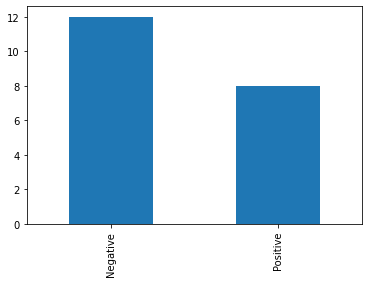

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

# southafrica

In [ ]:
df1 = dfsouthafrica.head(20)
southafrica_sentiment = []
check_sentiment(df1,southafrica_sentiment)
southafrica_sentiment

[[0.5000843]]
[[0.48551515]]
[[0.48904481]]
[[0.50482385]]
[[0.49686672]]
[[0.49915251]]
[[0.5064131]]
[[0.50048292]]
[[0.49899767]]
[[0.53145393]]
[[0.49923679]]
[[0.50340775]]
[[0.49791527]]
[[0.501533]]
[[0.49505855]]
[[0.49962803]]
[[0.50083127]]
[[0.47648268]]
[[0.50475315]]
[[0.49984033]]


['Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative',
 'Negative',
 'Positive',
 'Negative',
 'Positive',
 'Negative']

In [ ]:
list1 = [southafrica_sentiment]

# convert the list into dataframe row
data = pd.DataFrame(list1).T
data.columns = ['sentiment']

# display
data
##############

,sentiment
0,Positive
1,Negative
2,Negative
3,Positive
4,Negative
5,Negative
6,Positive
7,Positive
8,Negative
9,Positive


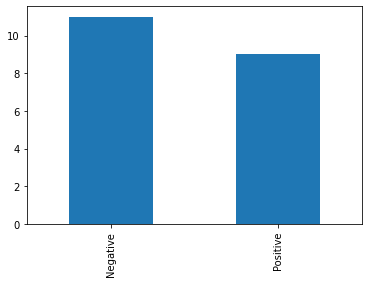

In [ ]:
x = data["sentiment"].value_counts().plot(kind='bar')
plt.show()

#